In [2]:
cd /scratch/qz2190

/scratch/qz2190


In [3]:
ls

FML_HW4.ipynb                      main.ipynb
Miniconda3-latest-Linux-x86_64.sh  my_env/
Untitled.ipynb                     paths.txt
Untitled2.ipynb                    project_clip_cluster_1.ipynb
captions.txt                       py_env/
coca_labeling.ipynb                yars_data/
coca_topk.ipynb                    yelp_dataset.tar*
diabetes.csv                       yelp_photos.tar


In [4]:
cd yars_data/

/scratch/qz2190/yars_data


In [5]:
ls

Dataset_User_Agreement.pdf  photos/      photos.tar     reviews/
base_out/                   photos.json  photos.tar.gz


In [6]:
cat /scratch/qz2190/yars_data/base_out/README.txt


# Explanation for features.pt and paths.txt
## features.pt
Use `torch.load("[dir]/features.pt")` to get list of tensors corresponding to output embeddings. This will yield a ~50Kx512 tensor. Each row corresponds to the 512 output features of an image. The first is empty. 
## paths.txt
This is a list file paths (ex123.jpg) that correspond to the features in features.pt. Each line corresponds to the associated index in features.pt. The first line is "empty" and should be ignored. 


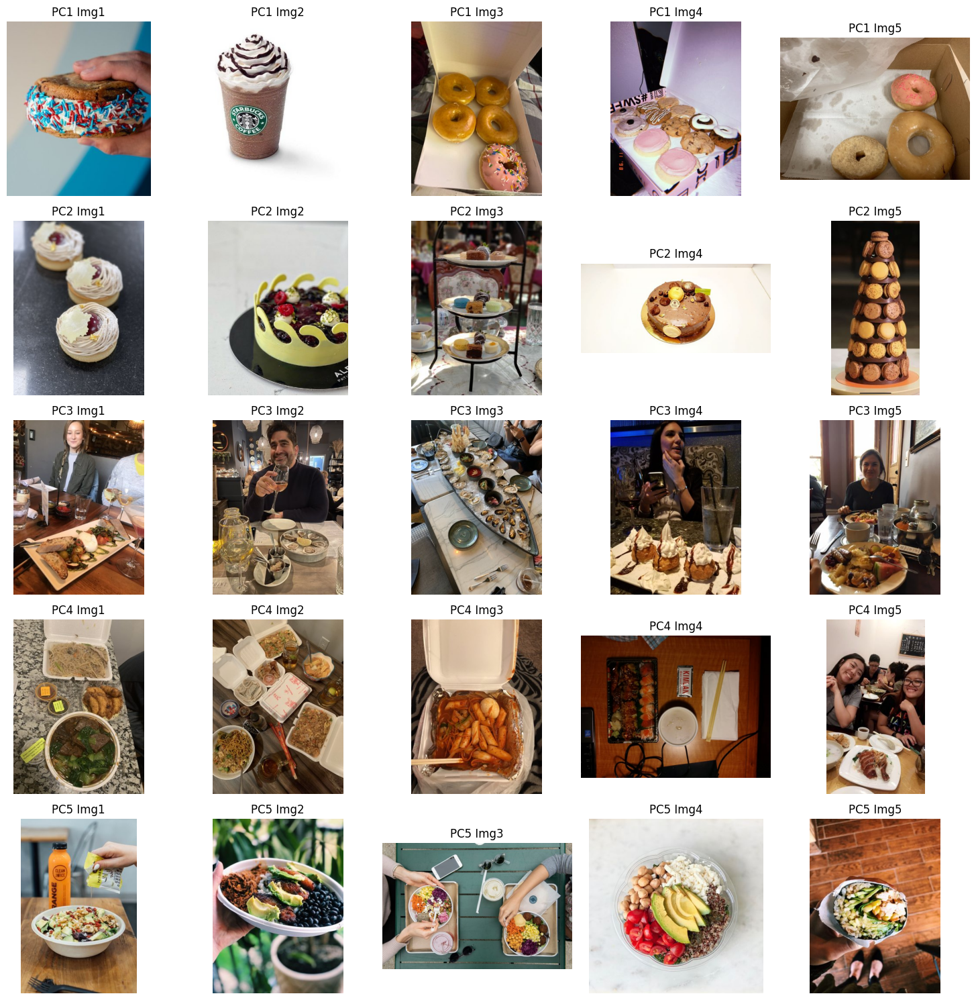

In [2]:
import torch
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

# Load embeddings
embeddings_path = '/scratch/qz2190/yars_data/base_out/features.pt'
embeddings = torch.load(embeddings_path)
embeddings = embeddings[1:]

# Load paths
paths_file = '/scratch/qz2190/yars_data/base_out/paths.txt'
with open(paths_file, 'r') as file:
    paths = file.readlines()
paths = paths[1:]

base_dir = '/scratch/qz2190/yars_data/photos/'
paths = [base_dir + path.strip() for path in paths]

pca = PCA(n_components=5)
pca_features = pca.fit_transform(embeddings)

# Display top 5 images for each of the first 5 PCA features
fig, axs = plt.subplots(5, 5, figsize=(15, 15))
for i in range(5):  # Loop over each PCA feature
    top_indices = np.argsort(pca_features[:, i])[::-1][:5]  # Get indices of top 5 values in feature i
    for j, idx in enumerate(top_indices):
        img_path = paths[idx]  # Get image path corresponding to the index
        img = Image.open(img_path)
        axs[i, j].imshow(img)
        axs[i, j].set_title(f'PC{i+1} Img{j+1}')
        axs[i, j].axis('off')
plt.tight_layout()
plt.show()

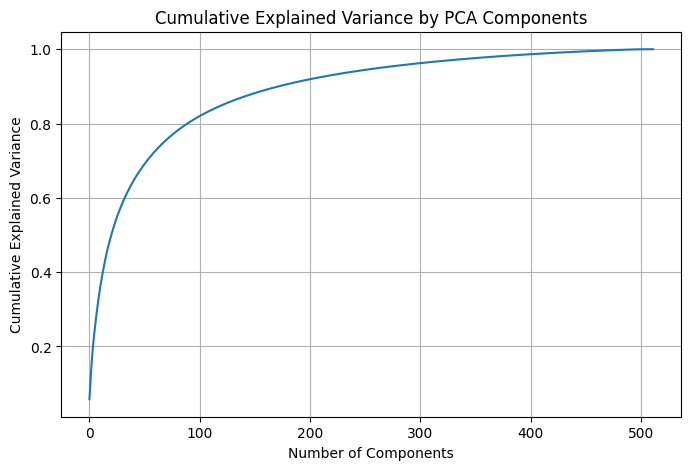

In [10]:
from mpl_toolkits.mplot3d import Axes3D

pca_full = PCA()
pca_full.fit(embeddings.numpy())
explained_var = pca_full.explained_variance_ratio_
cumulative_var = np.cumsum(explained_var)

plt.figure(figsize=(8, 5))
plt.plot(cumulative_var)
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance by PCA Components')
plt.grid(True)
plt.show()

Around 300 components seem to capture most of the variability in the data.

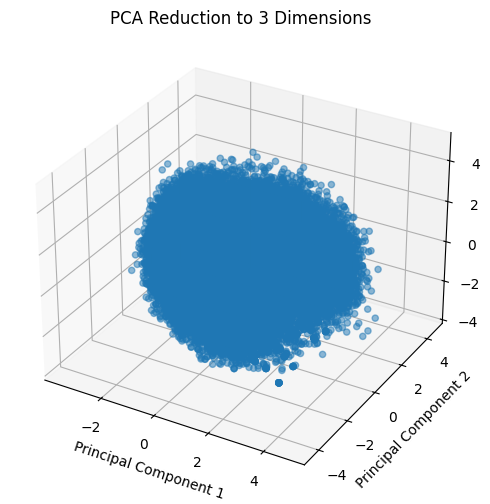

In [12]:
pca_3d = PCA(n_components=3)
reduced_3d = pca_3d.fit_transform(embeddings.numpy())

# 3D Visualization
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(reduced_3d[:, 0], reduced_3d[:, 1], reduced_3d[:, 2], alpha=0.5)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('PCA Reduction to 3 Dimensions')
plt.show()



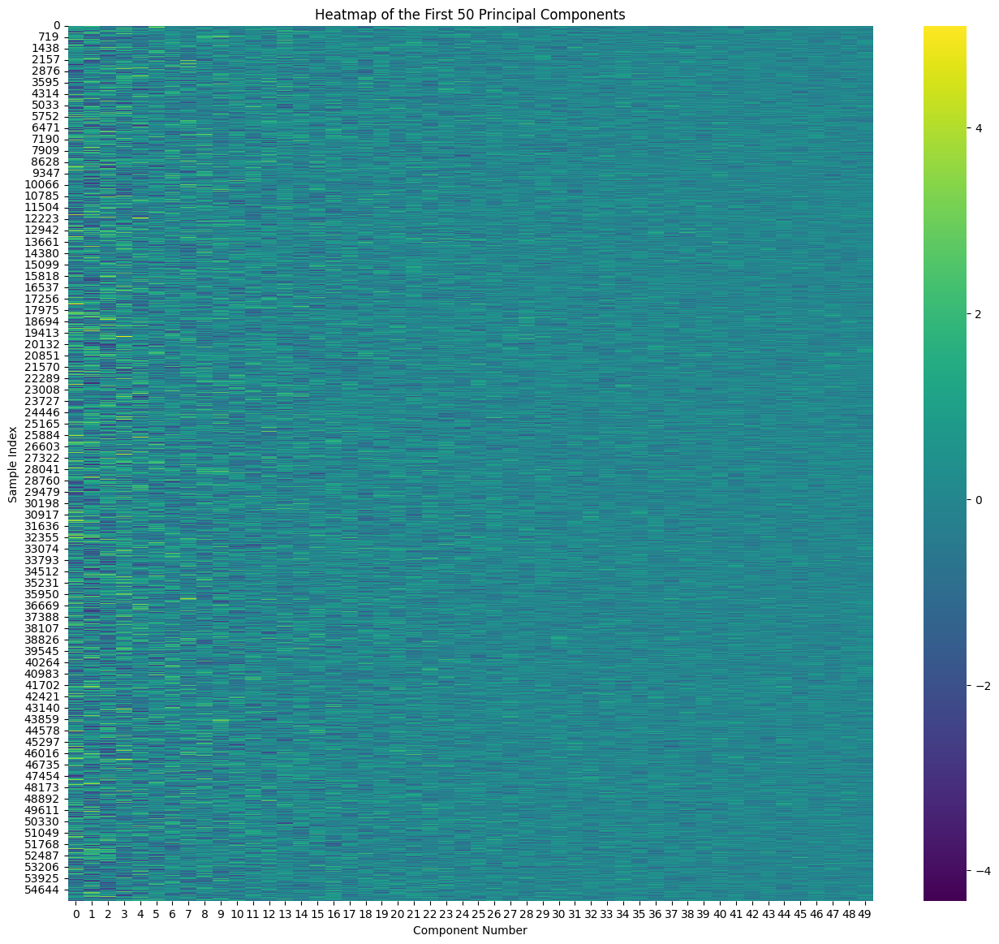

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt

embeddings_path = '/scratch/qz2190/yars_data/base_out/features.pt'
embeddings = torch.load(embeddings_path)
embeddings = embeddings[1:]

pca = PCA(n_components=50)
pca_results = pca.fit_transform(embeddings.numpy())

plt.figure(figsize=(16, 14))
sns.heatmap(pca_results[:, :50], cmap='viridis', cbar=True)
plt.title('Heatmap of the First 50 Principal Components')
plt.xlabel('Component Number')
plt.ylabel('Sample Index')
plt.show()


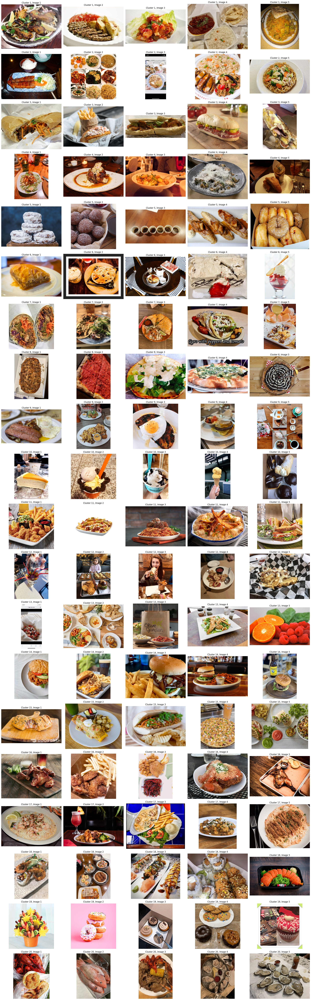

In [12]:
from sklearn.cluster import KMeans

photo_directory = '/scratch/qz2190/yars_data/photos/'
paths = [photo_directory + path for path in paths]

# Perform PCA to reduce to 300 components
pca = PCA(n_components=300)
pca_results = pca.fit_transform(embeddings.numpy())

n_clusters = 20
kmeans = KMeans(n_clusters=n_clusters, random_state=0)
clusters = kmeans.fit_predict(pca_results)

# Collect five images from each cluster
cluster_images = {i: [] for i in range(n_clusters)}
for i in range(len(clusters)):
    cluster = clusters[i]
    if len(cluster_images[cluster]) < 5:
        cluster_images[cluster].append(paths[i])
    if all(len(imgs) == 5 for imgs in cluster_images.values()):
        break

fig, axs = plt.subplots(n_clusters, 5, figsize=(25, 4 * n_clusters))
for i in range(n_clusters):
    for j in range(5):
        img = Image.open(cluster_images[i][j])
        axs[i, j].imshow(img)
        axs[i, j].set_title(f'Cluster {i+1}, Image {j+1}')
        axs[i, j].axis('off')
plt.tight_layout()
plt.show()


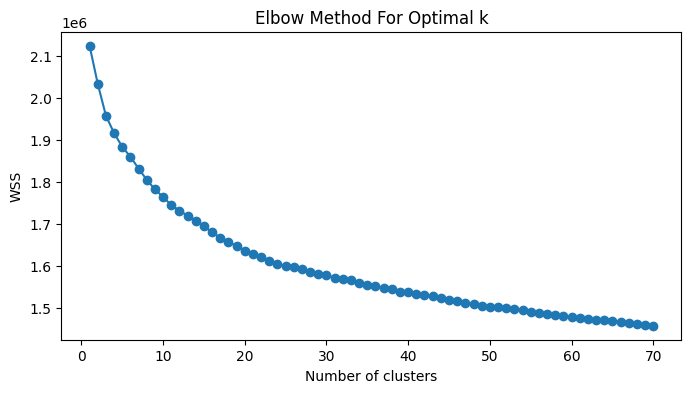

In [11]:
wss = []
for i in range(1, 71):
    kmeans = KMeans(n_clusters=i, random_state=0).fit(pca_results)
    wss.append(kmeans.inertia_)

plt.figure(figsize=(8, 4))
plt.plot(range(1, 71), wss, marker='o')
plt.title('Elbow Method For Optimal k')
plt.xlabel('Number of clusters')
plt.ylabel('WSS')
plt.show()


20 seems to be the best